# In this notebook, we segment the waveform into putative syllables
When a dataset is not pre-segmented into individiual vocal units, we can try to segment it computationally. Here we'll use dynamic thresholding segmentation to segment bouts into syllables.

This works very well with low-noise datasets with clearly defined syllables like Bengalese finch song. You might need to rely on other methods for noisier data. 

You can also try denoising your data first, e.g. with [noisereduce](https://github.com/timsainb/noisereduce) to get better results.

You'll need to install the [vocalseg](https://github.com/timsainb/vocalization-segmentation) package to use this. 

In [1]:
from avgn.utils.hparams import HParams
from avgn.dataset import DataSet

/mnt/cube/tsainbur/conda_envs/tpy3/lib/python3.6/site-packages/tqdm/autonotebook/__init__.py:14: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  " (e.g. in jupyter console)", TqdmExperimentalWarning)


In [2]:
DATASET_ID = 'koumura_bengalese_finch'

In [3]:
# create a set of hyperparameters for processing this dataset.  
hparams = HParams(
    num_mel_bins = 64,
    mel_lower_edge_hertz=500,
    mel_upper_edge_hertz=15000,
    butter_lowcut = 500,
    butter_highcut = 15000,
    ref_level_db = 20,
    min_level_db = -30,
    mask_spec = True,
    win_length_ms = 10,
    hop_length_ms = 2,
    nex=-1,
    n_jobs=-1,
    verbosity = 1,
)

### Create a dataset object
The dataset object loads JSONs corresponding to `DATASET_ID` in the data folder. 

In [4]:
# create a dataset object, which
dataset = DataSet(DATASET_ID, hparams = hparams)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    7.0s


[Parallel(n_jobs=-1)]: Done 1600 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 2720 tasks      | elapsed:    8.0s
[Parallel(n_jobs=-1)]: Done 2964 out of 2964 | elapsed:    8.1s finished


In [5]:
# to make sure everything loaded correctly, lets look at a sample JSON
print(json.dumps(dataset.sample_json, indent=4, default=str)[:400] + '...')

{
    "species": "Lonchura striata domestica",
    "common_name": "Bengalese finch",
    "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird8/Wave/108.wav",
    "samplerate_hz": 32000,
    "length_s": 8.8725,
    "indvs": {
        "Bird8": {
            "notes": {
                "start_times": [
                    1.158,
                    1.323,
...


In [6]:
# how many wavs are in the dataset?
len(dataset.data_files)

2964

### Perform segmentation

In [9]:
import librosa

In [11]:
### segmentation parameters
n_fft=1024
hop_length_ms=2
win_length_ms=4
ref_level_db=20
pre=0.97
min_level_db=-60
min_level_db_floor = -20
db_delta = 5
silence_threshold = 0.05
min_silence_for_spec=0.5
max_vocal_for_spec=0.5,
min_syllable_length_s = 0.01
butter_min = 500
butter_max = 15000
spectral_range = [500, 15000]

#### First lets try segmenting an example to make sure the segmentation looks good

In [23]:
from avgn.utils.audio import load_wav, read_wav
from vocalseg.dynamic_thresholding import dynamic_threshold_segmentation
from vocalseg.dynamic_thresholding import plot_segmented_spec, plot_segmentations
import matplotlib.pyplot as plt

In [17]:
rate, data = load_wav(dataset.data_files['Bird8_108'].data["wav_loc"])

In [20]:
# segment
results = dynamic_threshold_segmentation(
    data,
    rate,
    n_fft=n_fft,
    hop_length_ms=hop_length_ms,
    win_length_ms=win_length_ms,
    min_level_db_floor=min_level_db_floor,
    db_delta=db_delta,
    ref_level_db=ref_level_db,
    pre=pre,
    min_silence_for_spec=min_silence_for_spec,
    max_vocal_for_spec=max_vocal_for_spec,
    min_level_db=min_level_db,
    silence_threshold=silence_threshold,
    verbose=True,
    min_syllable_length_s=min_syllable_length_s,
    spectral_range=spectral_range,
)

longest silence 1.0999999999999996
longest vocalization 0.1039999999999992


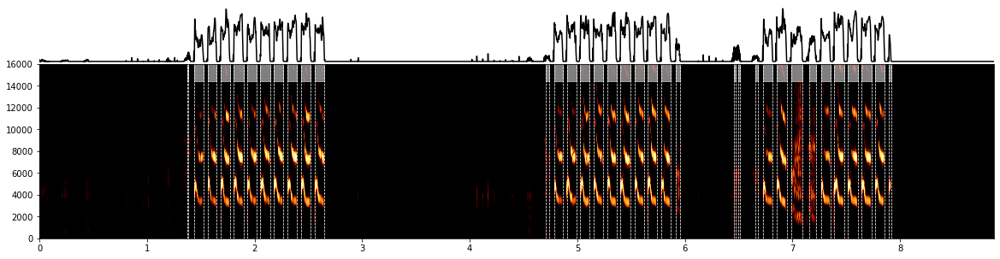

In [25]:
plot_segmentations(
    results["spec"],
    results["vocal_envelope"],
    results["onsets"],
    results["offsets"],
    hop_length_ms,
    rate,
    figsize=(20,5)
)
plt.show()

### Segment the full dataset 
- for each json, load the wav file - segment the file into start and end times
- plot the segmentation
- add to the JSON

In [36]:
from avgn.utils.json import NoIndent, NoIndentEncoder
import joblib
import warnings
import numpy as np
from tqdm.autonotebook import tqdm

In [38]:
from avgn.signalprocessing.filtering import butter_bandpass_filter

In [40]:
from avgn.utils.paths import DATA_DIR, most_recent_subdirectory, ensure_dir

In [29]:
warnings.filterwarnings("ignore", message = "'tqdm_notebook' object has no attribute 'sp'")

In [31]:
def segment_spec_custom(key, df, save=False, plot=False):
    # load wav
    rate, data = load_wav(df.data["wav_loc"])
    # filter data
    data = butter_bandpass_filter(data, butter_min, butter_max, rate)

    # segment
    results = dynamic_threshold_segmentation(
        data,
        rate,
        n_fft=n_fft,
        hop_length_ms=hop_length_ms,
        win_length_ms=win_length_ms,
        min_level_db_floor=min_level_db_floor,
        db_delta=db_delta,
        ref_level_db=ref_level_db,
        pre=pre,
        min_silence_for_spec=min_silence_for_spec,
        max_vocal_for_spec=max_vocal_for_spec,
        min_level_db=min_level_db,
        silence_threshold=silence_threshold,
        verbose=True,
        min_syllable_length_s=min_syllable_length_s,
        spectral_range=spectral_range,
    )
    if results is None:
        return
    if plot:
        plot_segmentations(
            results["spec"],
            results["vocal_envelope"],
            results["onsets"],
            results["offsets"],
            hop_length_ms,
            rate,
            figsize=(100, 5),
        )
        plt.show()

    # save the results
    json_out = (
        DATA_DIR
        / "processed"
        / (DATASET_ID + "_segmented")
        / DT_ID
        / "JSON"
        / (key + ".JSON")
    )

    json_dict = df.data.copy()

    json_dict["indvs"][list(df.data["indvs"].keys())[0]]["syllables"] = {
        "start_times": NoIndent(list(results["onsets"])),
        "end_times": NoIndent(list(results["offsets"])),
    }

    json_txt = json.dumps(json_dict, cls=NoIndentEncoder, indent=2)
    # save json
    if save:
        ensure_dir(json_out.as_posix())
        print(json_txt, file=open(json_out.as_posix(), "w"))

    print(json_txt)

    return results

In [34]:
indvs = np.array(['_'.join(list(i)) for i in dataset.json_indv])
np.unique(indvs)

array(['Bird0', 'Bird1', 'Bird10', 'Bird2', 'Bird3', 'Bird4', 'Bird5',
       'Bird6', 'Bird7', 'Bird8', 'Bird9'], dtype='<U6')

In [47]:
from datetime import datetime

In [48]:
# create a unique datetime identifier for the files output by this notebook
DT_ID = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
DT_ID

'2020-11-19_13-14-20'

Bird0


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.226
longest vocalization 0.11399999999999988


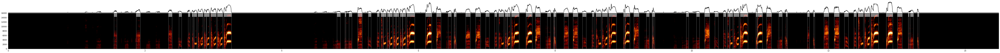

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird0/Wave/46.wav",
  "samplerate_hz": 32000,
  "length_s": 14.489,
  "indvs": {
    "Bird0": {
      "notes": {
        "start_times": [
          1.103,
          1.283,
          1.527,
          1.7,
          1.857,
          2.013,
          2.152,
          2.334,
          2.477,
          2.619,
          2.682,
          2.77,
          2.86,
          2.955,
          3.054,
          3.149,
          4.464,
          4.592,
          4.742,
          4.917,
          5.106,
          5.244,
          5.383,
          5.447,
          5.537,
          5.632,
          5.727,
          5.825,
          6.101,
          6.258,
          6.4,
          6.513,
          6.687,
          6.831,
          6.97,
          7.107,
          7.169,
          7.261,
          7.355,
          7.567,
          7.

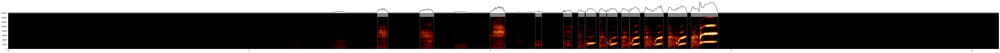

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.6s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird0/Wave/100.wav",
  "samplerate_hz": 32000,
  "length_s": 4.111,
  "indvs": {
    "Bird0": {
      "notes": {
        "start_times": [
          1.158,
          1.332,
          1.514,
          1.701,
          1.845,
          1.995,
          2.154,
          2.296,
          2.36,
          2.446,
          2.54,
          2.635,
          2.73,
          2.826
        ],
        "end_times": [
          1.222,
          1.41,
          1.584,
          1.775,
          1.913,
          2.074,
          2.228,
          2.348,
          2.445,
          2.537,
          2.63,
          2.729,
          2.825,
          2.954
        ],
        "labels": [
          "0",
          "0",
          "1",
          "1",
          "0",
          "1",
          "3",
          "4",
          "5",
          "5",
 

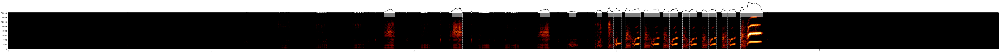

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird0/Wave/131.wav",
  "samplerate_hz": 32000,
  "length_s": 4.883,
  "indvs": {
    "Bird0": {
      "notes": {
        "start_times": [
          1.158,
          1.327,
          1.508,
          1.693,
          1.844,
          2.023,
          2.171,
          2.313,
          2.447,
          2.602,
          2.7495,
          2.8865,
          2.9495,
          3.0355,
          3.1295,
          3.2225,
          3.3165,
          3.4125,
          3.5075,
          3.6015
        ],
        "end_times": [
          1.201,
          1.393,
          1.585,
          1.766,
          1.915,
          2.087,
          2.248,
          2.382,
          2.523,
          2.678,
          2.8125,
          2.9375,
          3.0335,
          3.1245,
          3.2215,
          3.3125,
          3.4115,
      

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.168000000000001
longest vocalization 0.28199999999999914


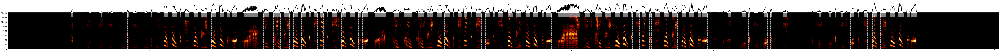

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird1/Wave/186.wav",
  "samplerate_hz": 32000,
  "length_s": 14.0595,
  "indvs": {
    "Bird1": {
      "notes": {
        "start_times": [
          1.068,
          1.257,
          1.405,
          1.57,
          1.681,
          1.756,
          1.899,
          2.01,
          2.084,
          2.19,
          2.308,
          2.425,
          2.494,
          2.615,
          2.736,
          2.866,
          2.9805,
          3.1045,
          3.1585,
          3.2925,
          3.5985,
          3.7565,
          3.9055,
          4.0335,
          4.1465,
          4.2615,
          4.3305,
          4.4135,
          4.5175,
          4.5905,
          4.7095,
          4.8335,
          4.9625,
          5.0215,
          5.1545,
          5.4565,
          5.6135,
          5.7865,
          5.9385,


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s


longest silence 1.0280000000000022
longest vocalization 0.28800000000000026


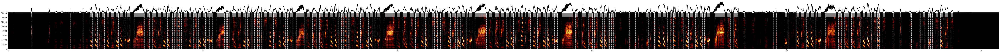

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird1/Wave/305.wav",
  "samplerate_hz": 32000,
  "length_s": 25.452,
  "indvs": {
    "Bird1": {
      "notes": {
        "start_times": [
          1.158,
          1.307,
          1.463,
          1.57,
          1.644,
          1.784,
          1.901,
          1.974,
          2.086,
          2.212,
          2.327,
          2.394,
          2.512,
          2.628,
          2.75,
          2.8595,
          2.9835,
          3.0385,
          3.1675,
          3.5415,
          3.6955,
          3.8405,
          3.9635,
          4.0775,
          4.1875,
          4.2565,
          4.3375,
          4.4395,
          4.5095,
          4.6305,
          4.7485,
          4.8715,
          4.9855,
          5.1045,
          5.1605,
          5.2875,
          5.5915,
          5.7495,
          5.8925,

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.8s remaining:    0.0s


longest silence 1.484
longest vocalization 0.29400000000000004


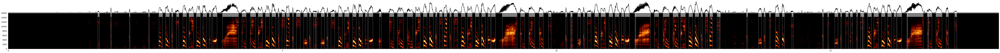

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird1/Wave/261.wav",
  "samplerate_hz": 32000,
  "length_s": 18.0625,
  "indvs": {
    "Bird1": {
      "notes": {
        "start_times": [
          1.071,
          1.247,
          1.413,
          1.578,
          1.74,
          1.856,
          1.929,
          2.075,
          2.195,
          2.266,
          2.421,
          2.544,
          2.619,
          2.728,
          2.856,
          2.97,
          3.04,
          3.165,
          3.289,
          3.42,
          3.532,
          3.656,
          3.715,
          3.856,
          4.245,
          4.404,
          4.551,
          4.678,
          4.795,
          4.909,
          4.9775,
          5.0635,
          5.1705,
          5.2425,
          5.3695,
          5.4785,
          5.5535,
          5.6845,
          5.7985,
          5.872

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    4.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    4.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
                                     

longest silence 1.168000000000001
longest vocalization 0.13000000000000078


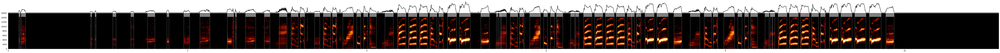

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird10/Wave/81.wav",
  "samplerate_hz": 32000,
  "length_s": 11.049,
  "indvs": {
    "Bird10": {
      "notes": {
        "start_times": [
          1.158,
          1.34,
          1.516,
          1.756,
          1.948,
          2.1,
          2.431,
          2.629,
          2.835,
          2.967,
          3.149,
          3.249,
          3.402,
          3.507,
          3.609,
          3.7185,
          3.8805,
          3.9555,
          4.0255,
          4.1565,
          4.3355,
          4.4575,
          4.5785,
          4.6975,
          4.7975,
          4.8955,
          5.0255,
          5.2645,
          5.4185,
          5.5935,
          5.6935,
          5.8045,
          5.9635,
          6.0415,
          6.1085,
          6.2365,
          6.4105,
          6.5325,
          6.6565,

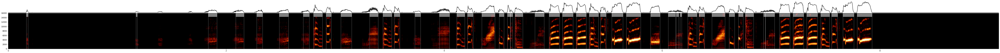

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird10/Wave/23.wav",
  "samplerate_hz": 32000,
  "length_s": 9.089,
  "indvs": {
    "Bird10": {
      "notes": {
        "start_times": [
          1.158,
          1.364,
          1.639,
          1.789,
          2.052,
          2.256,
          2.46,
          2.681,
          2.796,
          2.907,
          3.041,
          3.238,
          3.432,
          3.535,
          3.71,
          3.875,
          4.104,
          4.208,
          4.331,
          4.493,
          4.574,
          4.643,
          4.777,
          4.958,
          5.081,
          5.205,
          5.326,
          5.428,
          5.532,
          5.667,
          5.8825,
          6.0455,
          6.2295,
          6.3315,
          6.4455,
          6.6095,
          6.6895,
          6.7575,
          6.8915,
          7.07

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.9s remaining:    0.0s


longest silence 1.1620000000000008
longest vocalization 0.13400000000000034


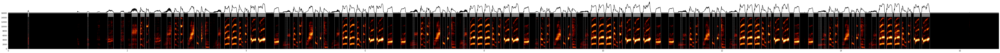

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird10/Wave/68.wav",
  "samplerate_hz": 32000,
  "length_s": 16.651,
  "indvs": {
    "Bird10": {
      "notes": {
        "start_times": [
          1.158,
          1.313,
          1.482,
          1.634,
          1.876,
          2.005,
          2.206,
          2.311,
          2.445,
          2.607,
          2.786,
          2.887,
          2.999,
          3.158,
          3.233,
          3.303,
          3.436,
          3.628,
          3.746,
          3.867,
          3.968,
          4.066,
          4.194,
          4.459,
          4.609,
          4.783,
          4.883,
          4.993,
          5.153,
          5.231,
          5.298,
          5.428,
          5.606,
          5.727,
          5.849,
          5.955,
          6.053,
          6.183,
          6.365,
          6.589,
   

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.1639999999999997
longest vocalization 0.1120000000000001


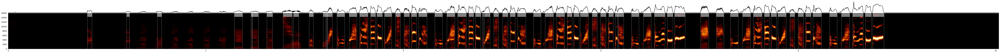

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird2/Wave/17.wav",
  "samplerate_hz": 32000,
  "length_s": 10.028,
  "indvs": {
    "Bird2": {
      "notes": {
        "start_times": [
          1.158,
          1.312,
          1.475,
          1.635,
          1.799,
          1.956,
          2.115,
          2.28,
          2.447,
          2.608,
          2.77,
          3.033,
          3.176,
          3.323,
          3.43,
          3.553,
          3.659,
          3.728,
          3.795,
          3.914,
          3.999,
          4.075,
          4.151,
          4.315,
          4.423,
          4.547,
          4.653,
          4.724,
          4.789,
          4.908,
          4.999,
          5.076,
          5.15,
          5.312,
          5.416,
          5.543,
          5.65,
          5.719,
          5.786,
          5.907,
          

longest silence 1.17
longest vocalization 0.1120000000000001


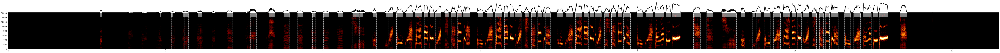

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.2s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird2/Wave/190.wav",
  "samplerate_hz": 32000,
  "length_s": 12.59,
  "indvs": {
    "Bird2": {
      "notes": {
        "start_times": [
          1.158,
          1.512,
          1.684,
          1.874,
          2.041,
          2.207,
          2.386,
          2.575,
          2.779,
          3.002,
          3.276,
          3.493,
          3.669,
          3.843,
          3.999,
          4.173,
          4.345,
          4.623,
          4.783,
          4.932,
          5.042,
          5.169,
          5.278,
          5.35,
          5.418,
          5.538,
          5.625,
          5.704,
          5.781,
          5.952,
          6.059,
          6.184,
          6.296,
          6.369,
          6.435,
          6.557,
          6.643,
          6.724,
          6.798,
          6.968,
      

longest silence 1.166
longest vocalization 0.1120000000000001


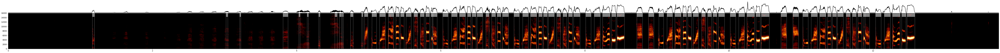

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird2/Wave/313.wav",
  "samplerate_hz": 32000,
  "length_s": 13.741,
  "indvs": {
    "Bird2": {
      "notes": {
        "start_times": [
          1.158,
          1.442,
          1.592,
          1.884,
          2.146,
          2.321,
          2.474,
          2.64,
          2.808,
          2.982,
          3.152,
          3.31,
          3.463,
          3.624,
          3.799,
          3.995,
          4.287,
          4.461,
          4.735,
          4.879,
          5.029,
          5.136,
          5.261,
          5.368,
          5.437,
          5.503,
          5.624,
          5.71,
          5.786,
          5.86,
          6.024,
          6.13,
          6.254,
          6.359,
          6.429,
          6.496,
          6.615,
          6.698,
          6.776,
          6.851,
         

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.2s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
                                     

longest silence 1.1660000000000004
longest vocalization 0.09600000000000009


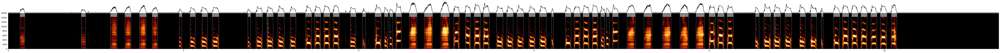

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird3/Wave/395.wav",
  "samplerate_hz": 32000,
  "length_s": 11.303,
  "indvs": {
    "Bird3": {
      "notes": {
        "start_times": [
          1.158,
          1.324,
          1.492,
          1.637,
          1.938,
          2.066,
          2.195,
          2.325,
          2.721,
          2.825,
          2.949,
          3.075,
          3.213,
          3.39,
          3.492,
          3.597,
          3.7,
          3.892,
          4.039,
          4.184,
          4.287,
          4.347,
          4.419,
          4.571,
          4.74,
          4.932,
          5.0765,
          5.2085,
          5.3125,
          5.4155,
          5.5675,
          5.6855,
          5.8025,
          5.9385,
          6.0615,
          6.1935,
          6.3505,
          6.4515,
          6.5545,
          6.

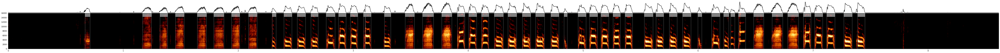

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird3/Wave/116.wav",
  "samplerate_hz": 32000,
  "length_s": 8.615,
  "indvs": {
    "Bird3": {
      "notes": {
        "start_times": [
          1.158,
          1.309,
          1.446,
          1.639,
          1.783,
          1.937,
          2.08,
          2.287,
          2.394,
          2.511,
          2.629,
          2.763,
          2.8675,
          2.9665,
          3.0865,
          3.2565,
          3.4445,
          3.5985,
          3.7635,
          3.9005,
          4.0015,
          4.1095,
          4.2265,
          4.3435,
          4.4675,
          4.585,
          4.716,
          4.825,
          4.952,
          5.051,
          5.152,
          5.255,
          5.36,
          5.527,
          5.632,
          5.745,
          5.862,
          5.992,
          6.115,
          6

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.9s remaining:    0.0s


longest silence 0.668
longest vocalization 0.13000000000000078


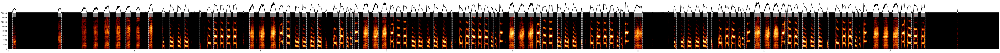

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird3/Wave/85.wav",
  "samplerate_hz": 32000,
  "length_s": 15.721,
  "indvs": {
    "Bird3": {
      "notes": {
        "start_times": [
          1.158,
          1.342,
          1.518,
          1.698,
          1.853,
          2.019,
          2.222,
          2.442,
          2.556,
          2.674,
          2.791,
          3.024,
          3.153,
          3.255,
          3.354,
          3.459,
          3.561,
          3.822,
          3.968,
          4.152,
          4.295,
          4.409,
          4.546,
          4.659,
          4.79,
          4.905,
          5.03,
          5.15,
          5.2545,
          5.3605,
          5.4195,
          5.4905,
          5.6225,
          5.7765,
          5.9185,
          6.0475,
          6.1555,
          6.2575,
          6.3905,
          6.50

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.1679999999999993
longest vocalization 0.08599999999999941


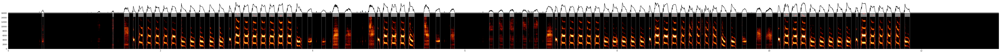

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird4/Wave/155.wav",
  "samplerate_hz": 32000,
  "length_s": 13.014,
  "indvs": {
    "Bird4": {
      "notes": {
        "start_times": [
          1.158,
          1.332,
          1.502,
          1.627,
          1.706,
          1.814,
          1.921,
          2.028,
          2.137,
          2.257,
          2.379,
          2.502,
          2.6305,
          2.7585,
          2.8915,
          2.9695,
          3.0835,
          3.1965,
          3.3085,
          3.4225,
          3.5375,
          3.6545,
          3.7725,
          3.9245,
          4.1045,
          4.2535,
          4.4145,
          4.7205,
          4.8405,
          4.9185,
          5.0265,
          5.1415,
          5.2555,
          5.4555,
          5.6055,
          5.7925,
          6.303,
          6.433,
          6.57

longest silence 1.184
longest vocalization 0.0860000000000003


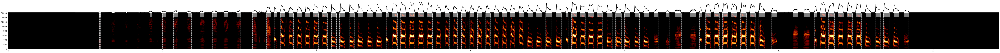

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.2s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird4/Wave/409.wav",
  "samplerate_hz": 32000,
  "length_s": 12.849,
  "indvs": {
    "Bird4": {
      "notes": {
        "start_times": [
          1.158,
          1.326,
          1.5,
          1.656,
          1.816,
          1.973,
          2.132,
          2.307,
          2.474,
          2.635,
          2.788,
          2.949,
          3.158,
          3.339,
          3.4385,
          3.5225,
          3.6315,
          3.7405,
          3.8435,
          3.9505,
          4.0655,
          4.1775,
          4.2925,
          4.4115,
          4.5265,
          4.6495,
          4.7685,
          4.8905,
          4.976,
          5.081,
          5.195,
          5.312,
          5.429,
          5.544,
          5.657,
          5.762,
          5.871,
          5.979,
          6.081,
         

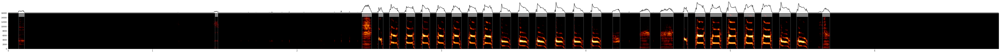

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird4/Wave/46.wav",
  "samplerate_hz": 32000,
  "length_s": 6.858,
  "indvs": {
    "Bird4": {
      "notes": {
        "start_times": [
          1.158,
          1.403,
          1.783,
          2.135,
          2.438,
          2.552,
          2.634,
          2.741,
          2.852,
          2.96,
          3.066,
          3.177,
          3.281,
          3.401,
          3.526,
          3.649,
          3.777,
          3.902,
          4.027,
          4.172,
          4.363,
          4.508,
          4.666,
          4.75,
          4.858,
          4.97,
          5.09,
          5.21,
          5.334,
          5.456,
          5.603
        ],
        "end_times": [
          1.198,
          1.471,
          1.848,
          2.211,
          2.525,
          2.606,
          2.714,
          2.

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
                                     

longest silence 1.1660000000000004
longest vocalization 0.09600000000000009


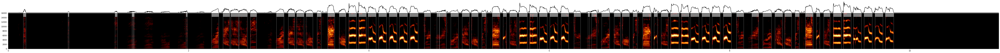

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.0s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird5/Wave/76.wav",
  "samplerate_hz": 32000,
  "length_s": 10.985,
  "indvs": {
    "Bird5": {
      "notes": {
        "start_times": [
          1.158,
          1.295,
          1.483,
          1.674,
          1.86,
          2.059,
          2.245,
          2.361,
          2.46,
          2.558,
          2.679,
          2.853,
          2.958,
          3.085,
          3.184,
          3.289,
          3.418,
          3.516,
          3.655,
          3.763,
          3.872,
          3.984,
          4.101,
          4.218,
          4.331,
          4.449,
          4.594,
          4.717,
          4.877,
          5.019,
          5.123,
          5.245,
          5.34,
          5.475,
          5.548,
          5.658,
          5.768,
          5.883,
          5.999,
          6.119,
        

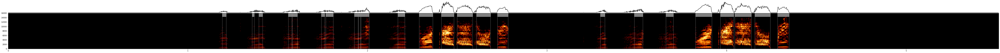

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.6s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird5/Wave/234.wav",
  "samplerate_hz": 32000,
  "length_s": 5.514,
  "indvs": {
    "Bird5": {
      "notes": {
        "start_times": [
          1.158,
          1.317,
          1.511,
          1.701,
          1.875,
          2.104,
          2.281,
          2.394,
          2.49,
          2.592,
          2.718,
          3.257,
          3.409,
          3.606,
          3.818,
          3.947,
          4.043,
          4.147,
          4.279
        ],
        "end_times": [
          1.237,
          1.439,
          1.635,
          1.825,
          2.018,
          2.221,
          2.37,
          2.489,
          2.591,
          2.693,
          2.791,
          3.346,
          3.545,
          3.732,
          3.925,
          4.043,
          4.144,
          4.251,
          4.357
        ]

longest silence 1.2
longest vocalization 0.11399999999999988


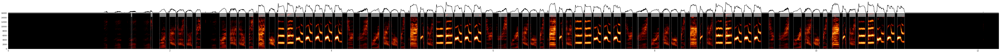

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird5/Wave/198.wav",
  "samplerate_hz": 32000,
  "length_s": 12.257,
  "indvs": {
    "Bird5": {
      "notes": {
        "start_times": [
          1.158,
          1.294,
          1.469,
          1.661,
          1.859,
          1.981,
          2.084,
          2.189,
          2.315,
          2.497,
          2.608,
          2.728,
          2.842,
          2.972,
          3.069,
          3.2145,
          3.3225,
          3.4375,
          3.5505,
          3.6675,
          3.7875,
          3.9085,
          4.0315,
          4.1855,
          4.3095,
          4.4695,
          4.6245,
          4.7265,
          4.8505,
          4.9475,
          5.0905,
          5.1685,
          5.2825,
          5.3995,
          5.5155,
          5.6365,
          5.7545,
          5.9045,
          6.027

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.7s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.1799999999999997
longest vocalization 0.08200000000000074


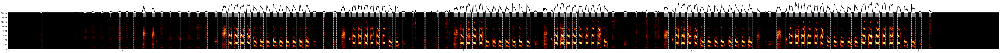

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.2s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird6/Wave/222.wav",
  "samplerate_hz": 32000,
  "length_s": 17.411,
  "indvs": {
    "Bird6": {
      "notes": {
        "start_times": [
          1.158,
          1.323,
          1.466,
          1.616,
          1.767,
          1.918,
          2.055,
          2.186,
          2.347,
          2.511,
          2.665,
          2.822,
          2.975,
          3.138,
          3.2955,
          3.4475,
          3.6115,
          3.7485,
          3.8625,
          3.9665,
          4.0725,
          4.1835,
          4.2995,
          4.4165,
          4.5275,
          4.6425,
          4.7565,
          4.8715,
          4.9865,
          5.1055,
          5.2215,
          5.3435,
          5.5195,
          5.6985,
          5.8365,
          5.9765,
          6.0375,
          6.1395,
          6.25

longest silence 1.1720000000000006
longest vocalization 0.08000000000000007


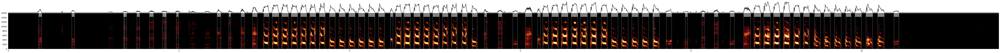

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.2s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird6/Wave/3.wav",
  "samplerate_hz": 32000,
  "length_s": 11.604,
  "indvs": {
    "Bird6": {
      "notes": {
        "start_times": [
          1.158,
          1.327,
          1.486,
          1.639,
          1.793,
          1.951,
          2.116,
          2.288,
          2.431,
          2.566,
          2.71,
          2.844,
          2.98,
          3.088,
          3.199,
          3.31,
          3.421,
          3.528,
          3.64,
          3.758,
          3.87,
          3.986,
          4.099,
          4.214,
          4.332,
          4.469,
          4.532,
          4.632,
          4.7465,
          4.8565,
          4.9675,
          5.0815,
          5.1865,
          5.3015,
          5.4185,
          5.5535,
          5.7225,
          5.9005,
          6.0415,
          6.1935,

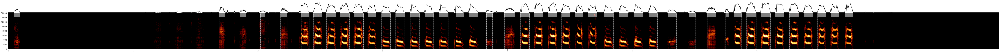

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird6/Wave/17.wav",
  "samplerate_hz": 32000,
  "length_s": 7.937,
  "indvs": {
    "Bird6": {
      "notes": {
        "start_times": [
          1.158,
          1.33,
          1.495,
          1.675,
          1.84,
          2.0,
          2.169,
          2.326,
          2.44,
          2.545,
          2.654,
          2.762,
          2.874,
          2.987,
          3.099,
          3.2145,
          3.3295,
          3.4475,
          3.5675,
          3.6845,
          3.8155,
          3.9685,
          4.0965,
          4.2065,
          4.3185,
          4.4265,
          4.5375,
          4.6425,
          4.7665,
          4.8875,
          5.0065,
          5.1255,
          5.2745,
          5.4385,
          5.5865,
          5.7305,
          5.8045,
          5.9085,
          6.0235,
    

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


longest silence 1.1660000000000004
longest vocalization 0.08800000000000097


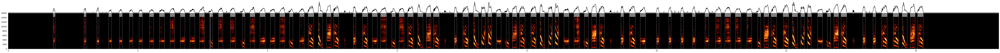

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.1s remaining:    0.0s
  0%|          | 0/8 [00:00<?, ?it/s]

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird7/Wave/27.wav",
  "samplerate_hz": 32000,
  "length_s": 15.274,
  "indvs": {
    "Bird7": {
      "notes": {
        "start_times": [
          1.158,
          1.355,
          1.54,
          1.696,
          1.856,
          2.005,
          2.166,
          2.323,
          2.484,
          2.642,
          2.788,
          2.94,
          3.082,
          3.232,
          3.412,
          3.575,
          3.719,
          3.874,
          4.029,
          4.179,
          4.316,
          4.483,
          4.614,
          4.772,
          4.903,
          5.007,
          5.171,
          5.316,
          5.451,
          5.605,
          5.739,
          5.891,
          6.021,
          6.152,
          6.305,
          6.441,
          6.547,
          6.718,
          6.873,
          7.0,
         

longest silence 1.1660000000000004
longest vocalization 0.08199999999999985


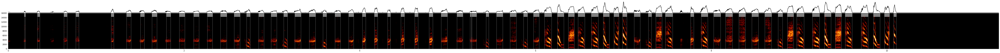

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird7/Wave/108.wav",
  "samplerate_hz": 32000,
  "length_s": 11.27,
  "indvs": {
    "Bird7": {
      "notes": {
        "start_times": [
          1.158,
          1.33,
          1.482,
          1.622,
          1.779,
          1.934,
          2.095,
          2.251,
          2.405,
          2.562,
          2.683,
          2.835,
          2.98,
          3.104,
          3.245,
          3.414,
          3.552,
          3.708,
          3.864,
          4.021,
          4.16,
          4.307,
          4.461,
          4.618,
          4.785,
          4.914,
          5.091,
          5.246,
          5.402,
          5.547,
          5.7,
          5.835,
          5.968,
          6.093,
          6.239,
          6.369,
          6.472,
          6.626,
          6.761,
          6.885,
          

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    1.9s remaining:    0.0s


longest silence 1.1679999999999993
longest vocalization 0.08399999999999963


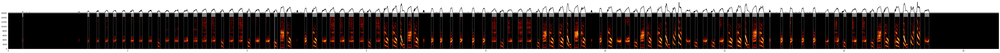

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird7/Wave/143.wav",
  "samplerate_hz": 32000,
  "length_s": 16.59,
  "indvs": {
    "Bird7": {
      "notes": {
        "start_times": [
          1.158,
          1.313,
          1.467,
          1.612,
          1.741,
          1.899,
          2.035,
          2.18,
          2.336,
          2.478,
          2.619,
          2.773,
          2.929,
          3.092,
          3.2375,
          3.3895,
          3.5405,
          3.6915,
          3.8445,
          3.9815,
          4.1315,
          4.3035,
          4.4305,
          4.5515,
          4.6525,
          4.8245,
          4.9575,
          5.0785,
          5.2505,
          5.3825,
          5.5465,
          5.6975,
          5.8725,
          6.0035,
          6.1495,
          6.2785,
          6.4245,
          6.5585,
          6.6815

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    3.1s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
                                     

longest silence 1.0999999999999996
longest vocalization 0.1039999999999992


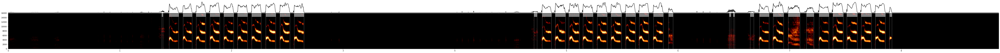

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird8/Wave/108.wav",
  "samplerate_hz": 32000,
  "length_s": 8.8725,
  "indvs": {
    "Bird8": {
      "notes": {
        "start_times": [
          1.158,
          1.323,
          1.43,
          1.553,
          1.672,
          1.795,
          1.92,
          2.046,
          2.17,
          2.294,
          2.422,
          2.548,
          4.375,
          4.508,
          4.668,
          4.771,
          4.889,
          5.016,
          5.137,
          5.263,
          5.389,
          5.519,
          5.641,
          5.767,
          6.424,
          6.612,
          6.717,
          6.838,
          6.971,
          7.125,
          7.251,
          7.374,
          7.504,
          7.628,
          7.755
        ],
        "end_times": [
          1.239,
          1.411,
          1.533,
        

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.7s remaining:    0.0s


longest silence 2.834
longest vocalization 0.11000000000000032


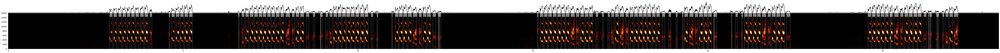

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.3s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird8/Wave/77.wav",
  "samplerate_hz": 32000,
  "length_s": 28.315,
  "indvs": {
    "Bird8": {
      "notes": {
        "start_times": [
          1.158,
          1.431,
          1.573,
          1.745,
          1.94,
          2.143,
          2.373,
          2.57,
          2.782,
          2.884,
          3.005,
          3.141,
          3.26,
          3.385,
          3.507,
          3.63,
          3.765,
          3.89,
          4.034,
          4.202,
          4.35,
          4.535,
          4.659,
          4.782,
          4.908,
          5.032,
          5.162,
          6.257,
          6.524,
          6.653,
          6.769,
          6.896,
          7.026,
          7.152,
          7.272,
          7.396,
          7.519,
          7.646,
          7.777,
          7.921,
          8

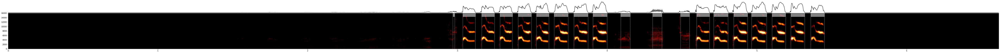

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird8/Wave/139.wav",
  "samplerate_hz": 32000,
  "length_s": 6.615,
  "indvs": {
    "Bird8": {
      "notes": {
        "start_times": [
          1.158,
          1.341,
          1.503,
          1.697,
          1.924,
          2.121,
          2.325,
          2.546,
          2.744,
          2.916,
          3.023,
          3.149,
          3.271,
          3.394,
          3.514,
          3.641,
          3.769,
          3.892,
          4.043,
          4.255,
          4.466,
          4.583,
          4.705,
          4.832,
          4.957,
          5.09,
          5.214,
          5.351
        ],
        "end_times": [
          1.212,
          1.437,
          1.624,
          1.823,
          2.049,
          2.263,
          2.481,
          2.657,
          2.834,
          3.007,
       

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.9s finished


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
                                     

longest silence 1.1720000000000006
longest vocalization 0.07599999999999962


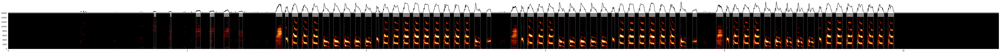

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird9/Wave/47.wav",
  "samplerate_hz": 32000,
  "length_s": 11.063,
  "indvs": {
    "Bird9": {
      "notes": {
        "start_times": [
          1.158,
          1.307,
          1.447,
          1.592,
          1.774,
          1.941,
          2.078,
          2.234,
          2.396,
          2.559,
          2.708,
          2.845,
          2.974,
          3.085,
          3.1635,
          3.2755,
          3.3895,
          3.5085,
          3.6255,
          3.7425,
          3.8595,
          3.9785,
          4.0995,
          4.1805,
          4.2895,
          4.4035,
          4.5155,
          4.6315,
          4.7455,
          4.8575,
          4.9725,
          5.0855,
          5.1995,
          5.3325,
          5.4645,
          5.6035,
          5.7185,
          5.7935,
          5.902

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.9s remaining:    0.0s


longest silence 0.9879999999999995
longest vocalization 0.08200000000000074


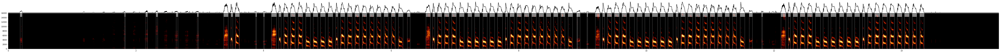

[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    2.0s remaining:    0.0s
                                     

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird9/Wave/167.wav",
  "samplerate_hz": 32000,
  "length_s": 15.52,
  "indvs": {
    "Bird9": {
      "notes": {
        "start_times": [
          1.158,
          1.305,
          1.461,
          1.618,
          1.783,
          1.935,
          2.125,
          2.288,
          2.427,
          2.589,
          2.756,
          2.916,
          3.086,
          3.225,
          3.36,
          3.4735,
          3.5495,
          3.8365,
          3.9815,
          4.1105,
          4.2335,
          4.3105,
          4.4185,
          4.5355,
          4.6545,
          4.7705,
          4.8875,
          5.0055,
          5.1235,
          5.2025,
          5.3105,
          5.4255,
          5.5405,
          5.6555,
          5.7675,
          5.8805,
          6.0005,
          6.1055,
          6.2355,

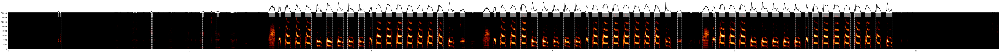

{
  "species": "Lonchura striata domestica",
  "common_name": "Bengalese finch",
  "wav_loc": "/mnt/cube/tsainbur/Projects/github_repos/avgn_paper/data/raw/koumura/zip_contents/Bird9/Wave/76.wav",
  "samplerate_hz": 32000,
  "length_s": 10.913,
  "indvs": {
    "Bird9": {
      "notes": {
        "start_times": [
          1.158,
          1.358,
          1.537,
          1.745,
          1.928,
          2.093,
          2.26,
          2.429,
          2.582,
          2.725,
          2.858,
          2.966,
          3.041,
          3.153,
          3.2645,
          3.3825,
          3.4975,
          3.6155,
          3.7315,
          3.8505,
          3.9695,
          4.0445,
          4.1525,
          4.2685,
          4.3845,
          4.4965,
          4.6095,
          4.7235,
          4.839,
          4.97,
          5.083,
          5.221,
          5.335,
          5.411,
          5.523,
          5.636,
          5.754,
          5.874,
          5.992,
          

[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:    2.8s finished


In [49]:
nex = 3
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv][:nex]

    joblib.Parallel(n_jobs=1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], plot=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

### Generate segmentations for the full dataset

In [50]:
nex = -1
for indv in tqdm(np.unique(indvs), desc="individuals"):
    print(indv)
    indv_keys = np.array(list(dataset.data_files.keys()))[indvs == indv]

    joblib.Parallel(n_jobs=-1, verbose=11)(
            joblib.delayed(segment_spec_custom)(key, dataset.data_files[key], save=True) 
                 for key in tqdm(indv_keys, desc="files", leave=False)
        )

Bird0


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   15.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:   15.7s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:   15.8s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:   15.8s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:   15.8s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:   15.9s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:   15.9s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

Bird1


[Parallel(n_jobs=-1)]: Done 135 out of 135 | elapsed:   19.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    1.0s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    1.1s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    7.4s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    7.5s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    7.5s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    7.6s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    7.7s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    7.8s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    7.9s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    8.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    8.1s
[Parallel(n_jobs=-1)]: Done 148 tasks      | elapsed:    8.2s
[Parallel(n_jobs=-1)]: Done 149 tasks      | elapsed:    8.3s
[Paralle

Bird10


[Parallel(n_jobs=-1)]: Done 315 out of 315 | elapsed:   18.1s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

Bird2


[Parallel(n_jobs=-1)]: Done  94 out of  94 | elapsed:    3.2s remaining:    0.0s
[Parallel(n_jobs=-1)]: Done  94 out of  94 | elapsed:    3.2s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 148 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 149 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-1)]: Done 150 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-1)]: Done 151 tasks      | elapsed:    5.9s
[Paralle

[Parallel(n_jobs=-1)]: Done 270 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 271 tasks      | elapsed:   10.5s
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 273 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 274 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 307 out of 339 | elapsed:   12.0s remaining:    1.2s


Bird3


[Parallel(n_jobs=-1)]: Done 339 out of 339 | elapsed:   13.1s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    4.7s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    4.8s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    4.9s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    5.0s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 148 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 149 tasks      | elapsed:    5.1s
[Paralle

[Parallel(n_jobs=-1)]: Done 267 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done 268 tasks      | elapsed:    9.1s
[Parallel(n_jobs=-1)]: Done 269 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 270 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 271 tasks      | elapsed:    9.2s
[Parallel(n_jobs=-1)]: Done 272 tasks      | elapsed:    9.3s
[Parallel(n_jobs=-1)]: Done 273 tasks      | elapsed:    9.3s
[Parallel(n_jobs=-1)]: Done 274 tasks      | elapsed:    9.3s
[Parallel(n_jobs=-1)]: Done 275 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done 276 tasks      | elapsed:    9.4s
[Parallel(n_jobs=-1)]: Done 277 tasks      | elapsed:    9.5s
[Parallel(n_jobs=-1)]: Done 278 tasks      | elapsed:    9.5s
[Parallel(n_jobs=-1)]: Done 279 tasks      | elapsed:    9.5s
[Parallel(n_jobs=-1)]: Done 280 tasks      | elapsed:    9.6s
[Parallel(n_jobs=-1)]: Done 281 tasks      | elapsed:    9.6s
[Parallel(n_jobs=-1)]: Done 282 tasks      | elapsed:    9.6s
[Paralle

Bird4


[Parallel(n_jobs=-1)]: Done 402 out of 402 | elapsed:   13.6s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1930s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  14 ta

[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:    5.8s
[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:    5.9s
[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:    6.0s
[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 214 tasks      | elapsed:    6.2s
[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 218 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 220 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 222 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 224 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 226 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 228 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 230 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 232 tasks      | elapsed:    6.7s
[Paralle

[Parallel(n_jobs=-1)]: Done 362 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 363 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 364 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 365 tasks      | elapsed:   10.6s
[Parallel(n_jobs=-1)]: Done 366 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 367 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 368 tasks      | elapsed:   10.7s
[Parallel(n_jobs=-1)]: Done 369 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-1)]: Done 371 tasks      | elapsed:   10.8s
[Parallel(n_jobs=-1)]: Done 372 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 373 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 374 tasks      | elapsed:   10.9s
[Parallel(n_jobs=-1)]: Done 375 tasks      | elapsed:   11.0s
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   11.0s
[Parallel(n_jobs=-1)]: Done 377 tasks      | elapsed:   11.0s
[Paralle

Bird5


[Parallel(n_jobs=-1)]: Done 441 out of 441 | elapsed:   12.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Batch computation too fast (0.1804s.) Setting batch_size=2.
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done  14 ta

[Parallel(n_jobs=-1)]: Done 190 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 194 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 196 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 198 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done 200 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done 202 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done 204 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done 206 tasks      | elapsed:    7.0s
[Parallel(n_jobs=-1)]: Done 208 tasks      | elapsed:    7.1s
[Parallel(n_jobs=-1)]: Done 210 tasks      | elapsed:    7.1s
[Parallel(n_jobs=-1)]: Done 212 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-1)]: Done 214 tasks      | elapsed:    7.2s
[Parallel(n_jobs=-1)]: Done 216 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 218 tasks      | elapsed:    7.3s
[Parallel(n_jobs=-1)]: Done 220 tasks      | elapsed:    7.4s
[Paralle

Bird6


[Parallel(n_jobs=-1)]: Done 334 out of 334 | elapsed:   10.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 133 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 148 tasks      | elapsed:    5.7s
[Paralle

Bird7


[Parallel(n_jobs=-1)]: Done 235 out of 235 | elapsed:    8.5s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.2s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    5.1s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    5.2s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    5.3s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    5.4s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    5.5s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 148 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 149 tasks      | elapsed:    5.6s
[Parallel(n_jobs=-1)]: Done 150 tasks      | elapsed:    5.7s
[Parallel(n_jobs=-1)]: Done 151 tasks      | elapsed:    5.7s
[Paralle

Bird8


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

Bird9


[Parallel(n_jobs=-1)]: Done 142 out of 142 | elapsed:    3.8s finished


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 32 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:    0.4s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:    0.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:    0.6s
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:    0.7s
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:    0.8s
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:    0.9s
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  

[Parallel(n_jobs=-1)]: Done 132 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 133 tasks      | elapsed:    6.3s
[Parallel(n_jobs=-1)]: Done 134 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 135 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 136 tasks      | elapsed:    6.4s
[Parallel(n_jobs=-1)]: Done 137 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 138 tasks      | elapsed:    6.5s
[Parallel(n_jobs=-1)]: Done 139 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 140 tasks      | elapsed:    6.6s
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 142 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 143 tasks      | elapsed:    6.7s
[Parallel(n_jobs=-1)]: Done 144 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 145 tasks      | elapsed:    6.8s
[Parallel(n_jobs=-1)]: Done 146 tasks      | elapsed:    6.9s
[Parallel(n_jobs=-1)]: Done 147 tasks      | elapsed:    6.9s
[Paralle